#Trying to visualize the ebola phylogeny tree on a geography map
---

###Load the tree

In [1]:
import ete2
mytree=ete2.Tree('ebola_phylo',format=1)

###Small class to store data associated with nodes

In [2]:
import datetime
class My_node:
    def __init__(self,name):
        self.name=name
        self.country,self.district,self.date=None,None,None
        self.lattitude,self.longitude=None,None
        if (len(name.split('_'))>5):
            self.country=name.split('_')[4]
            self.district=name.split('_')[5]
            temp_date=map(int,name.split('_')[-3:])
            self.date=datetime.date(temp_date[0],temp_date[1],temp_date[2])
            
    def __repr__(self):
        return '\nName: '+str(self.name)+'\nCountry: '+str(
            self.country)+'\nDistrict: '+str(self.district)+'\nDate: '+str(
            self.date)+'Coordinates: '+str(self.lattitude)+','+str(self.longitude)+  '\n\n'
            
    def __string__(self):
        return '\nName: '+str(self.name)+'\nCountry: '+str(
          self.country)+'\nDistrict: '+str(self.district)+'\nDate: '+str(
            self.date)+'Coordinates: '+str(self.lattitude)+','+str(self.longitude) + '\n\n'

###Read geolocation, and time data from the names of leaves
- country, district

In [3]:
my_nodes_dict=dict()
for node in mytree.traverse():
    my_nodes_dict[node.name]=My_node(node.name)

###Assign geolocation data, and timestamp to inner nodes of the tree too
- They will be plotted too, so they need a location
- Location of the inner node will be the location of the child which is the closest.

In [4]:
while (not my_nodes_dict[mytree.get_tree_root().name].country !=None):
    for node in mytree.traverse():
        if ( [my_nodes_dict[x.name].country !=None  for x in node.get_children()].count(False)==0 ):
            mindist=1e6
            for child in node.get_children():
                if (child.dist < mindist):
                    mindist=child.dist
                    my_nodes_dict[node.name].country=my_nodes_dict[child.name].country
                    my_nodes_dict[node.name].district=my_nodes_dict[child.name].district
                    my_nodes_dict[node.name].date=my_nodes_dict[child.name].date

###Plot the result on ETE2 circle plot

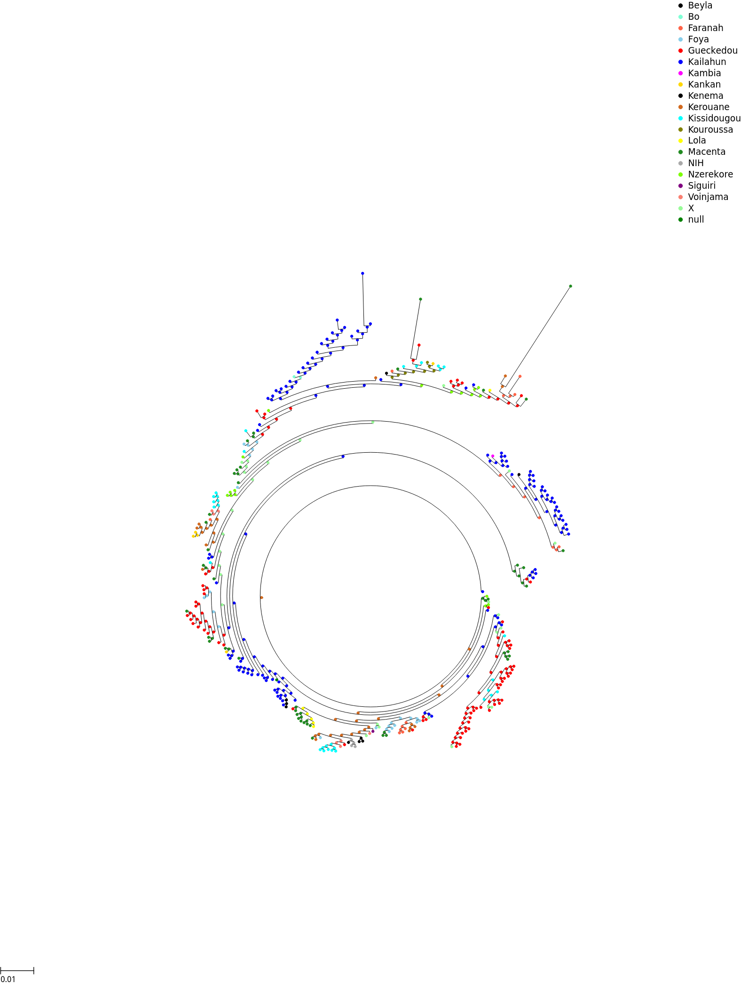

In [5]:
#assign colors to districts
mycolors=['aquamarine','yellow','green','purple','magenta','black','blue','tomato', 'red', 'black', 
          'darkgrey', 'lawngreen', 'chocolate', 'salmon', 'forestgreen', 'palegreen', 'skyblue',
          'gold', 'olive','cyan']
districts=set([my_nodes_dict[node.name].district  for node in mytree.traverse()])
dist_colors=dict([[list(districts)[i],mycolors[i]] for i in xrange(len(districts)) ])
    
#set style to nothing, and color nodes
nstyle = ete2.NodeStyle()
nstyle["size"] = 0
for node in mytree.traverse():
    node.set_style(nstyle)
    node.add_face(ete2.CircleFace(2,dist_colors[my_nodes_dict[node.name].district] ,
                                  style="circle"),column=0,position='branch-right' )

my_style = ete2.TreeStyle()
my_style.mode = "c"
my_style.root_opening_factor=0.8
my_style.show_leaf_name=False
my_style.arc_start=0

for district in sorted(dist_colors.keys()):
    my_style.legend.add_face(ete2.CircleFace(3, dist_colors[district]), column=0)
    my_style.legend.add_face(ete2.TextFace('  '+district), column=1)

mytree.render("%%inline", h=600, units="mm", tree_style=my_style)

###Load the tree to a networkx graph object through BioPython

In [6]:
from Bio import Phylo
from cStringIO import StringIO
import networkx as nx
g=Phylo.to_networkx(Phylo.read(StringIO(mytree.write(format=8)),'newick'))

###Tweak the country and district names
- Abbreviations
- Missing values 

In [7]:
#Have to rename countries
country_code_dict=dict()
country_code_dict['DPR1']='Mali'
country_code_dict['DPR2']='Mali'
country_code_dict['GUI']='Guinea'
country_code_dict['SLe']='Sierra Leone'
country_code_dict['SLE']='Sierra Leone'
country_code_dict['LIB']='Liberia'
country_code_dict['X']='Guinea' #???

#Have to rename some cities
district_code_dict=dict([[x,x] for x in districts])
district_code_dict['NIH']='Bamako' #???
district_code_dict['null']='' #???
district_code_dict['X']='' #???

#rename them
for node in my_nodes_dict.values():
    node.country,node.district=country_code_dict[node.country],district_code_dict[node.district]

###Find geolocation with the help of Geo package and and Google Maps

In [8]:
from geopy.geocoders import GoogleV3
geolocator = GoogleV3()
import time
for node in my_nodes_dict.values():
    location,(lattitude,longitude) = geolocator.geocode(node.country+' '+node.district)
    node.lattitude,node.longitude=lattitude,longitude
    time.sleep(0.3) #wait a little, otherwise google kicks us out

###'Root' node lost its name during conversion

In [9]:
graph_names=set([x.name for x in g.nodes()])
missing_name=''
for node in my_nodes_dict.values():
    if( not node.name in graph_names):
        missing_name= node.name
for node in g.nodes():
    if(node.name==None):
        node.name=missing_name

###Plot the tree on the map

- Color the leaves by date of sample collection

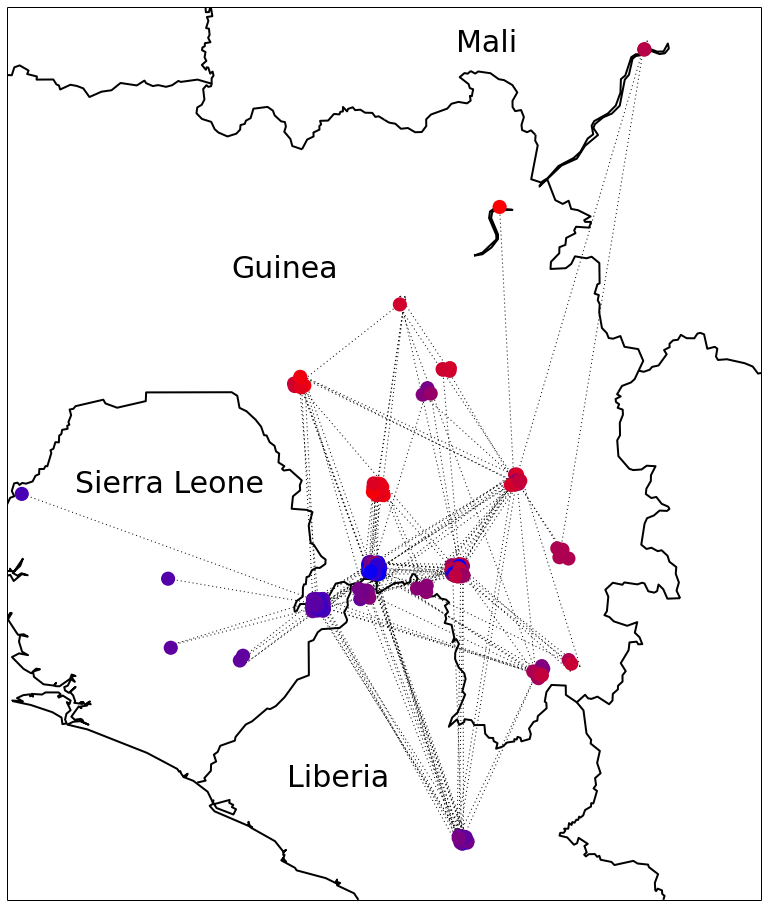

In [10]:
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
from mpl_toolkits.basemap import Basemap as Basemap
import numpy as np

#the basemap object
m = Basemap(projection='merc',llcrnrlon=-13,llcrnrlat=6,urcrnrlon=-7,urcrnrlat=13,
            lat_ts=0,resolution='i',suppress_ticks=True)

#assign continous colors to dates
dates=set([x.date for x in my_nodes_dict.values() ])   
date_colors=dict([ [sorted(dates)[i],'#%02X%02X%02X' % 
                    (255*i/float(len(dates)),0,255-255*i/float(len(dates)))] for i in xrange(len(dates)) ])

# position in decimal lat/lon
lats,lons,col,size=[],[],[],[]
for node in g.nodes():
    #positions
    lats.append(my_nodes_dict[node.name].lattitude+0.1*np.random.rand()) #little random noise
    lons.append(my_nodes_dict[node.name].longitude+0.1*np.random.rand())
    #color by date, dont show inner nodes
    col.append(date_colors[my_nodes_dict[node.name].date])
    if(node.name[:5]=='Inner'):
        size.append(0)
    else:
        size.append(200)  

# convert lat and lon to map projection
mx,my=m(lons,lats)
# put map projection coordinates in pos dictionary
pos,i={},0
for node in g.nodes():
    pos[node]=(mx[i],my[i])
    i+=1

fig,ax=plt.subplots()
fig.set_size_inches(16,16)
#put country names on
matplotlib.rc('font', size=30)
ax.text(400000,750000,'Mali')
ax.text(200000,550000,'Guinea')
ax.text(60000,360000,'Sierra Leone')
ax.text(250000,100000,'Liberia')
# Now draw the map
m.drawcountries(linewidth=2)
m.drawcoastlines(linewidth=2)
m.drawmapboundary()

# draw the nodes
nx.draw_networkx(g,pos,node_size=size,with_labels=False,node_color=col,linewidths=0,style='dotted')

###Animate the growth of the graph


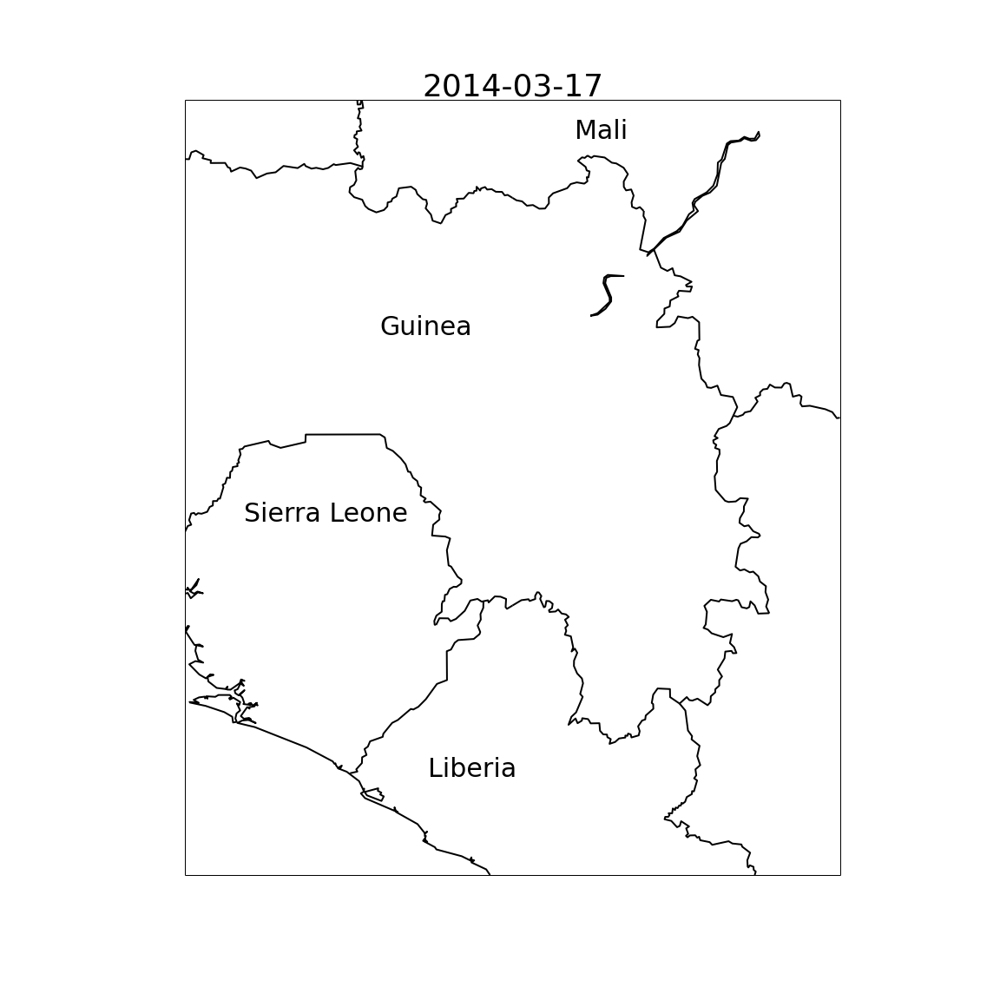
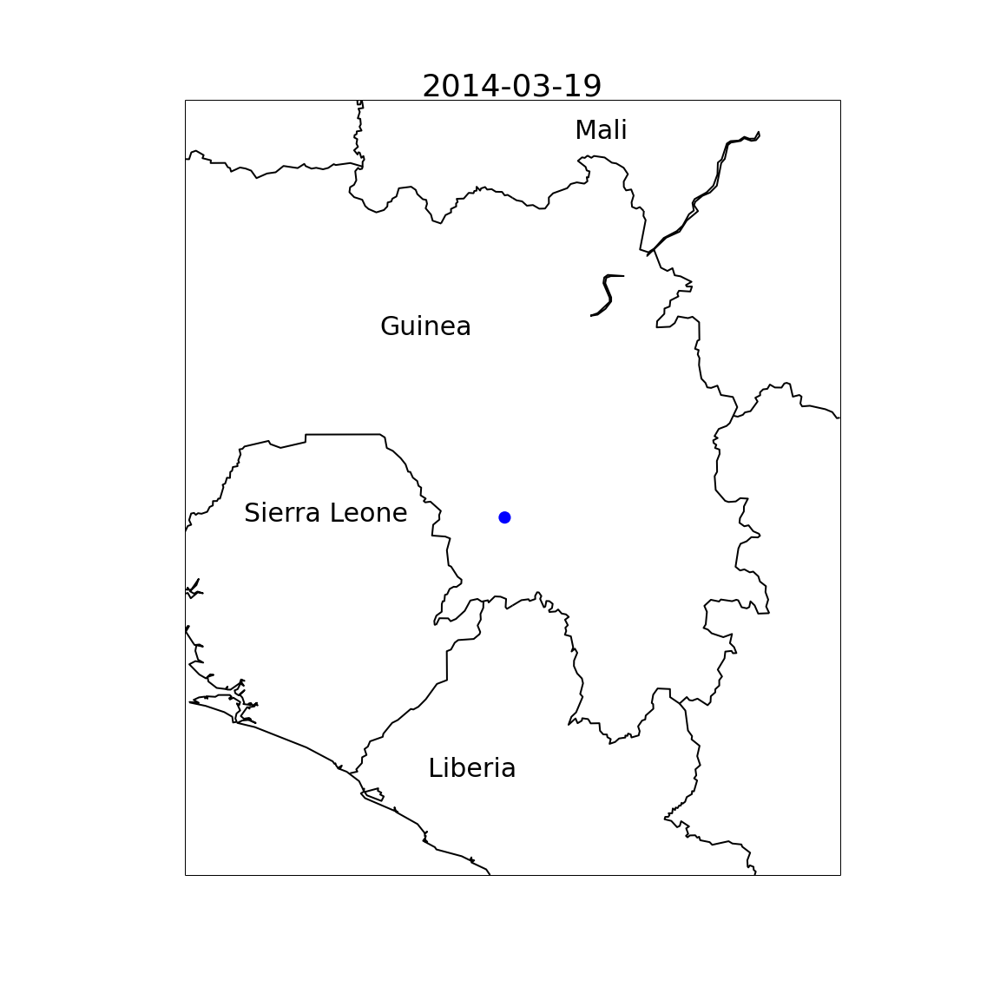
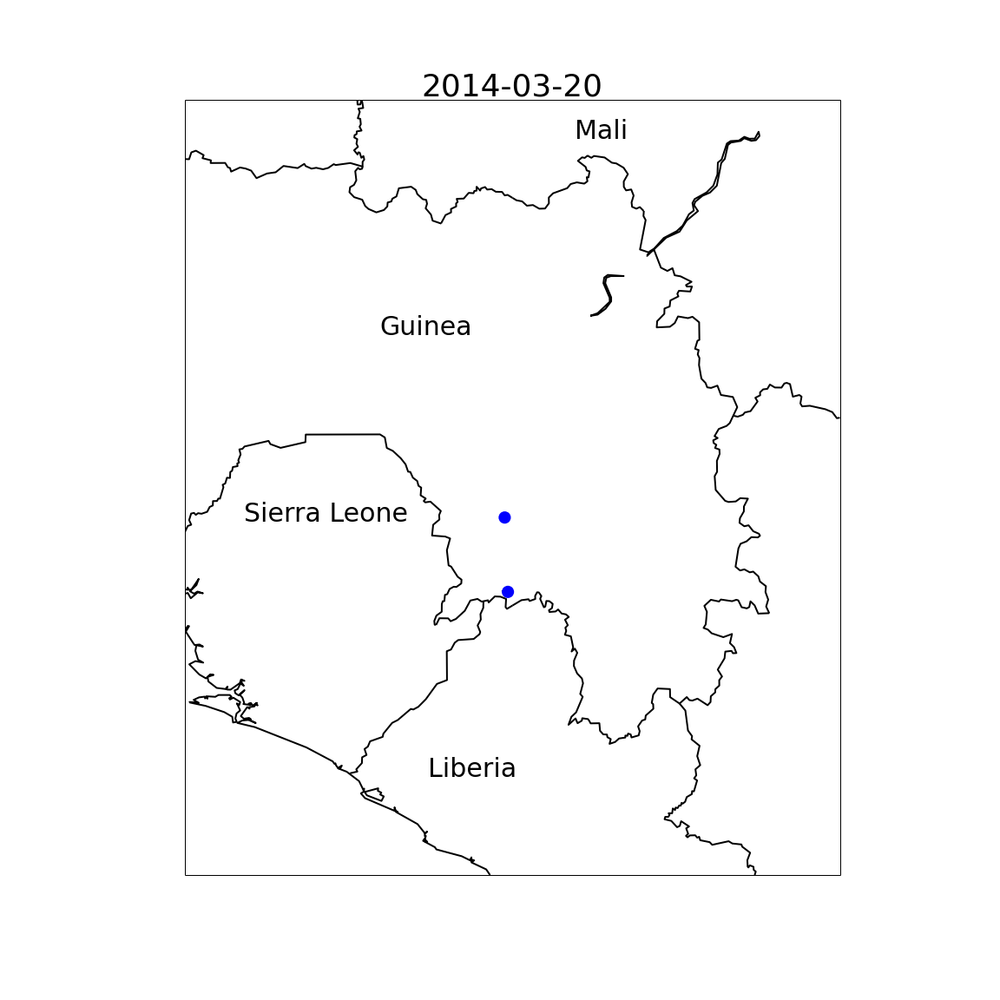
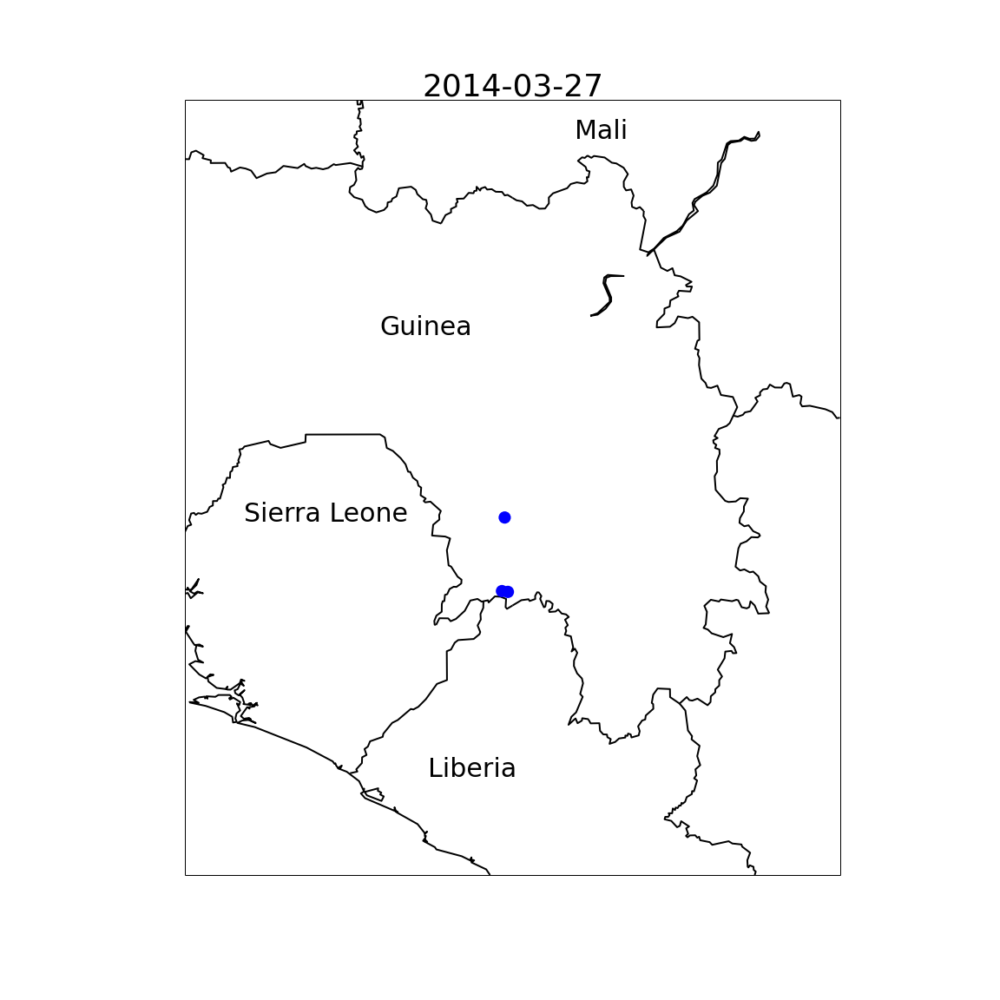
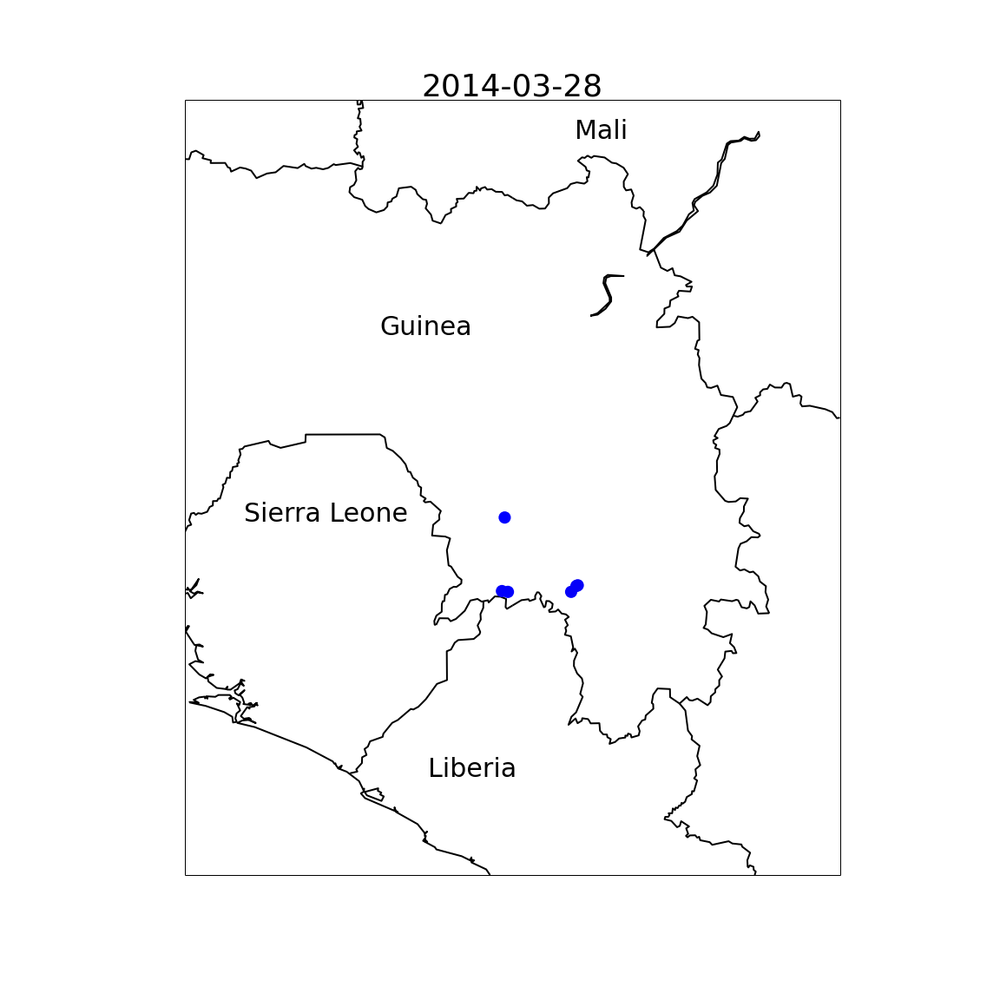
...
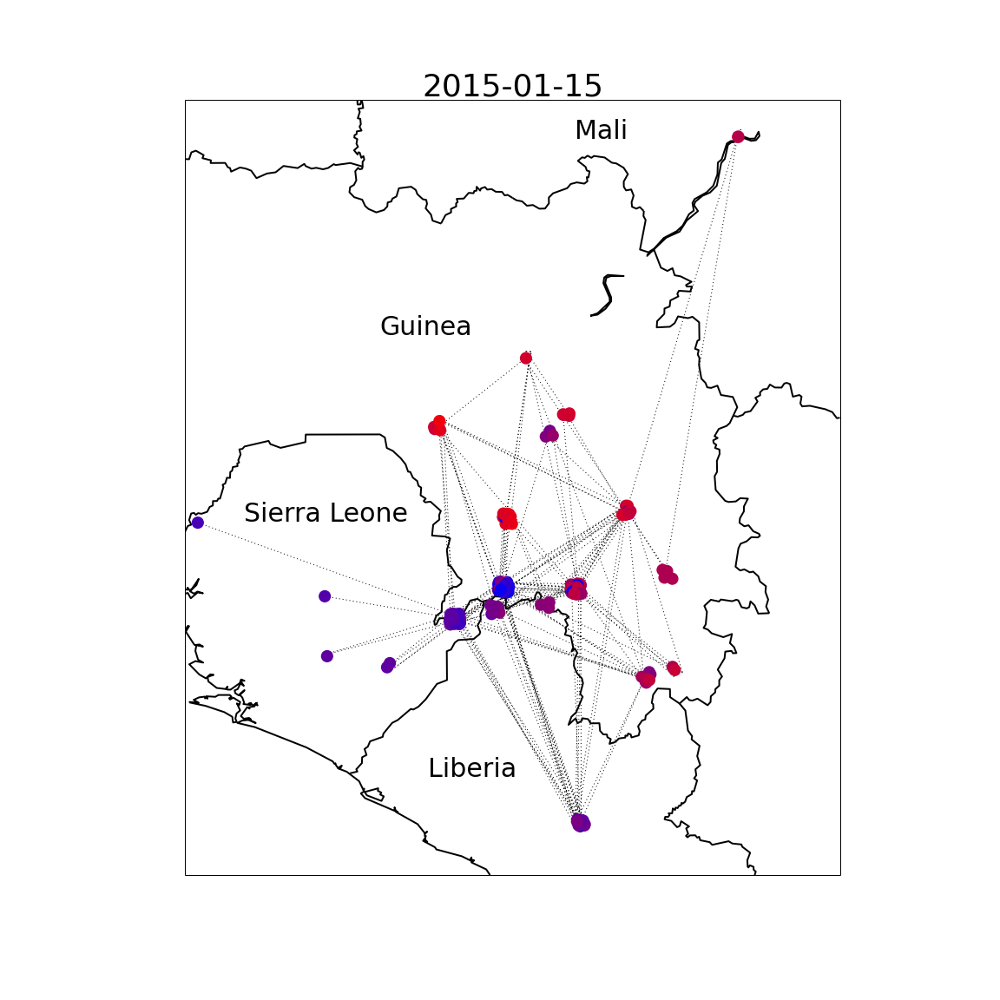
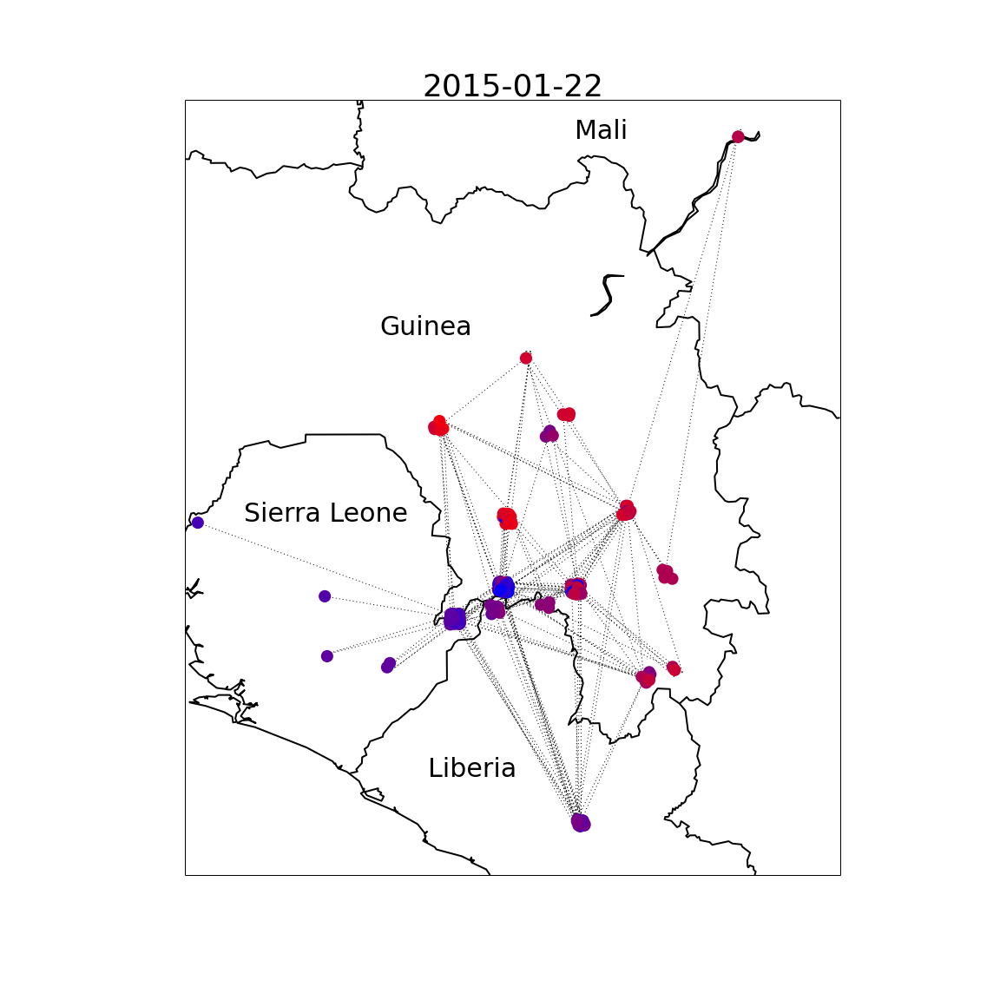
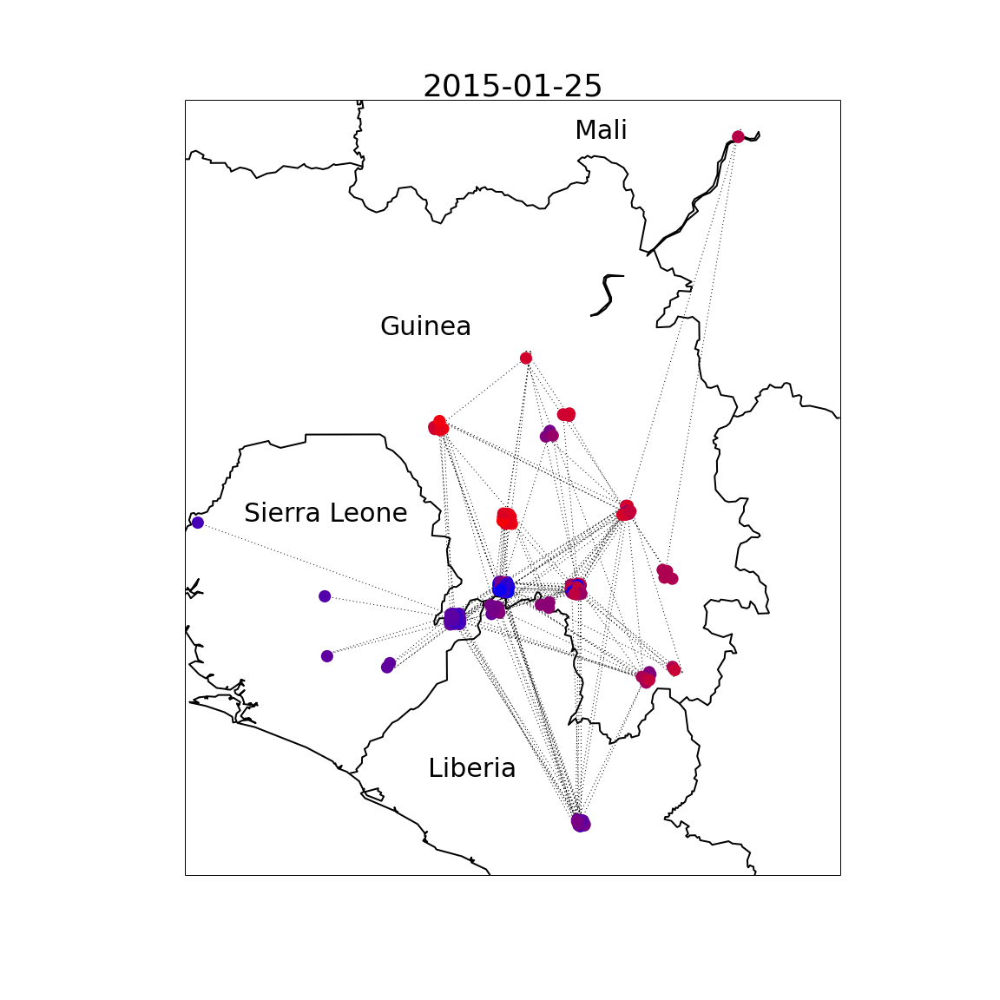
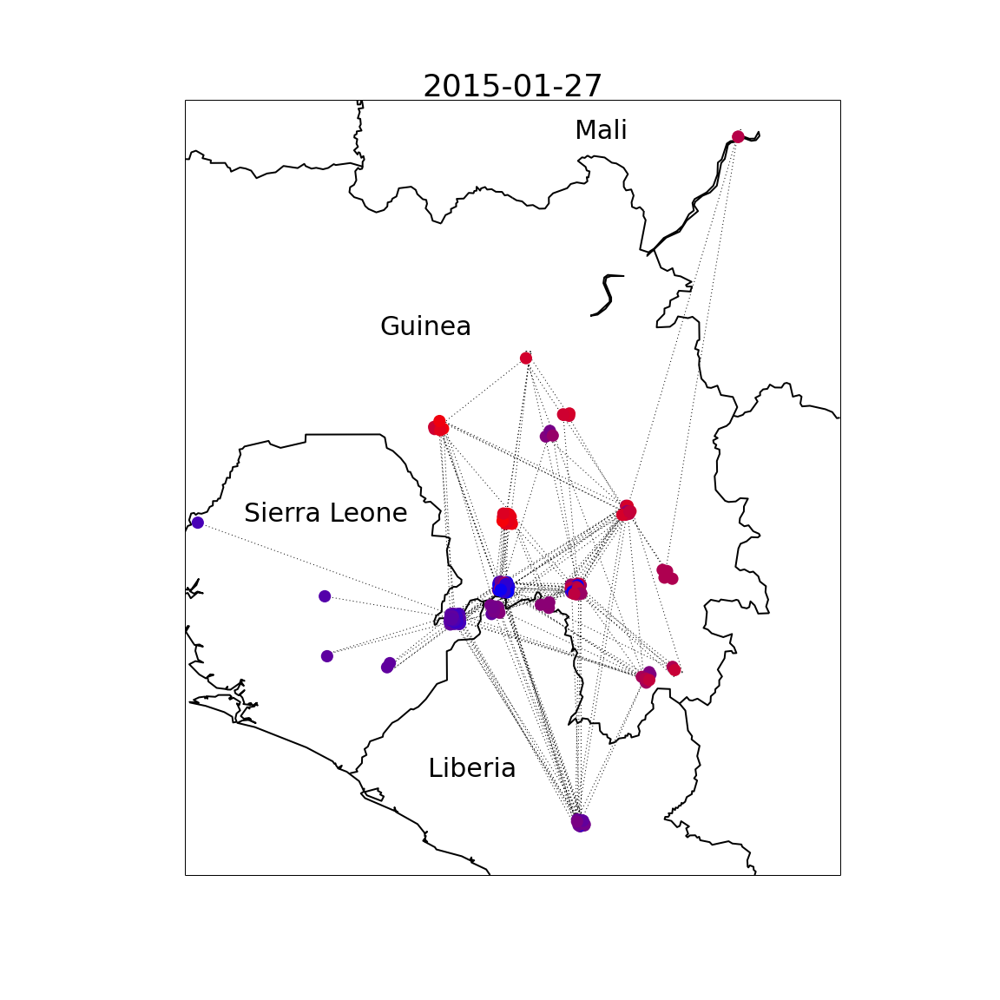
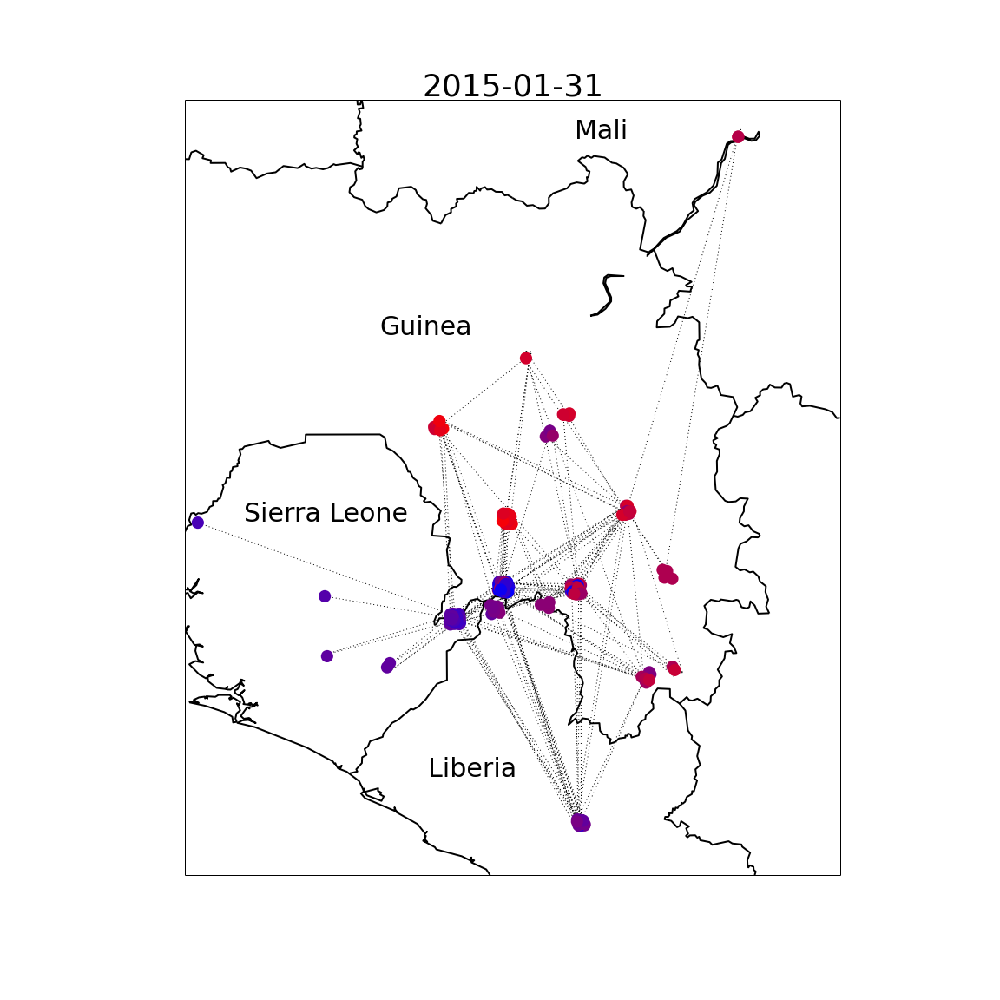

In [11]:
from JSAnimation import IPython_display
from matplotlib.animation import FuncAnimation
import datetime

fig,ax=plt.subplots()
fig.set_size_inches(16,16)

#the basemap object
m = Basemap(projection='merc',llcrnrlon=-13,llcrnrlat=6,urcrnrlon=-7,urcrnrlat=13,
            lat_ts=0,resolution='i',suppress_ticks=True)

# convert lat and lon to map projection
mx,my=m(lons,lats)

# put map projection coordinates in pos dictionary
pos,i={},0
for node in g.nodes():
    pos[node]=(mx[i],my[i])
    i+=1

#positions
lats,lons=[],[]
for node in g.nodes():
    lats.append(my_nodes_dict[node.name].lattitude+0.1*np.random.rand()) #little random noise
    lons.append(my_nodes_dict[node.name].longitude+0.1*np.random.rand())
      
#assign continous colors to dates
dates=set([x.date for x in my_nodes_dict.values() ])
date_colors=dict([ [sorted(dates)[i],'#%02X%02X%02X' % 
                    (255*i/float(len(dates)),0,255-255*i/float(len(dates)))] for i in xrange(len(dates)) ])

#function to update the plot during animation
def update(n):
    ax.cla()
    date_limit=sorted(dates)[n%(len(dates))]
    ax.set_title(str(date_limit))
    
    m = Basemap(projection='merc',llcrnrlon=-13,llcrnrlat=6,urcrnrlon=-7,urcrnrlat=13,
            lat_ts=0,resolution='i',suppress_ticks=True,ax=ax)

    # Now draw the map
    m.drawcountries(linewidth=2)
    m.drawcoastlines(linewidth=2)
    m.drawmapboundary()
    #put country names on
    matplotlib.rc('font', size=30)
    ax.text(400000,750000,'Mali')
    ax.text(200000,550000,'Guinea')
    ax.text(60000,360000,'Sierra Leone')
    ax.text(250000,100000,'Liberia')
    
    #select nodes to plot
    nodes_2_plot=[]
    col,size=[],[]
    for node in g.nodes():
        if( my_nodes_dict[node.name].date < date_limit):
            nodes_2_plot.append(node)
            col.append(date_colors[my_nodes_dict[node.name].date])
            if ( node.name[:5]!='Inner'):
                size.append(200)
            else:
                size.append(0)

    #select edges
    nodeset=set([x.name for x in nodes_2_plot])
    edges_2_plot=[]
    for edge in g.edges():
        if ( (edge[0].name in nodeset) and (edge[1].name in nodeset) ):
            edges_2_plot.append(edge)

    #return the changes
    nodes = nx.draw_networkx_nodes(g,pos,node_color=col,nodelist=nodes_2_plot,node_size=size,ax=ax,linewidths=0)
    edges = nx.draw_networkx_edges(g,pos,ax=ax,edgelist=edges_2_plot,style='dotted') 
    return nodes,edges

#animate
FuncAnimation(fig,update,frames=len(dates), interval=100, blit=True)